In [1]:
using Distributions, Random

In [2]:
using Plots,LaTeXStrings #load in visualization software

[Bryan Clark's Generative Model](https://illinois-compphys.github.io/ComputationalPhysics/ML/Diffusion.html)

In [6]:
using Logging
debug_logger=ConsoleLogger(stderr, Logging.Debug);

In [8]:
function ForwardDiffusion(x_0,T,delta::Number)
    @debug "running ForwardDiffusion with arguments" x_0 T delta
    eta=Normal(0., 1.)
    result=Array{typeof(x_0)}(undef,T)
    x=x_0
    result[1]=x
    for j in 2:T
        x+= -(delta/2)*x+sqrt(delta)*rand(eta)
        result[j]=x
    end
    #@debug "returning" result
    return result
end

ForwardDiffusion (generic function with 1 method)

┌ Debug: running ForwardDiffusion with arguments
│   x_0 = 0.4
│   T = 10000
│   delta = 0.05
└ @ Main In[8]:2


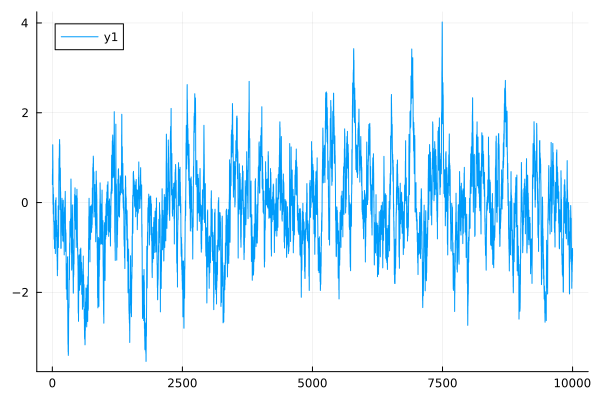

In [24]:
with_logger(debug_logger) do # Enable the debug logger locally
   global p1=ForwardDiffusion(0.4,10000,0.05)
end
plot(p1)

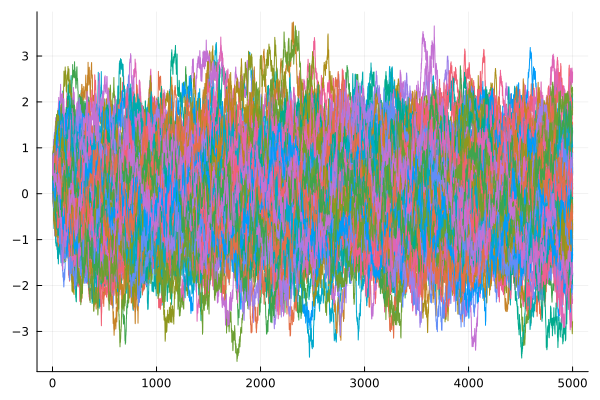

In [42]:
walks=[ForwardDiffusion(0.4,5000,0.01) for j in 1:100]
plot(walks,label=false)

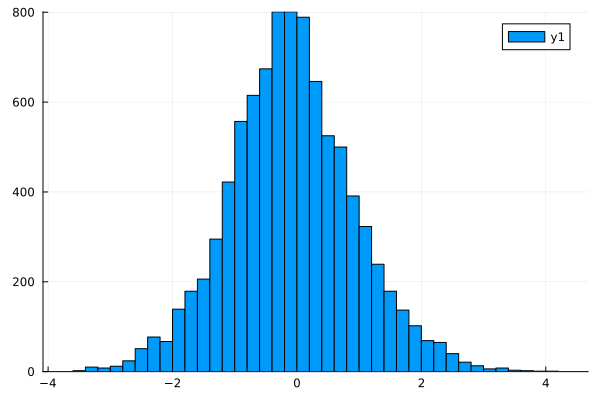

In [34]:
histogram(p1[1001:end])

In [15]:
function ForwardDiffusion(x_0,T,beta_t::AbstractVector)
    eta=Normal(0., 1.)
    result=Array{typeof(x_0)}(undef,T)
    x=x_0
    #result[1]=x
    for j in 1:T
        x= sqrt(1-beta_t[j])*x+sqrt(beta_t[j])*rand(eta)
    #    result[j]=x
    end
    #return result
    return x
end

ForwardDiffusion (generic function with 2 methods)

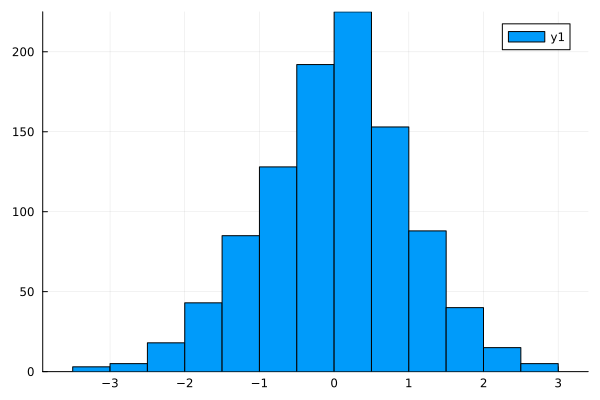

In [37]:
data=[ForwardDiffusion(0.4,200,LinRange(0.0001, 0.05,200)) for j in 1:1000]
histogram(data)

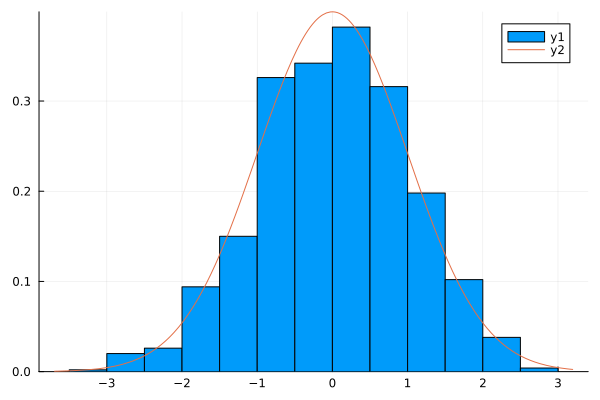

In [19]:
histogram(data,normalize=true)
plot!(x->(1/sqrt(2*pi))*exp(-(x^2)/2))

In [20]:
function ForwardDiffusionFast(x_0,T,alpha_bar::AbstractVector)
    eta=Normal(0., 1.)
    return sqrt(alpha_bar[T])*x_0+sqrt(1-alpha_bar[T])*rand(eta)
end

ForwardDiffusionFast (generic function with 1 method)

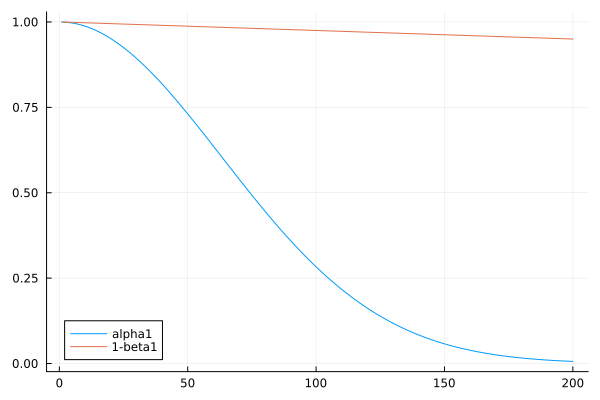

In [21]:
beta1=LinRange(0.0001, 0.05,200)
alpha1_bar=Array{Float64,1}(undef,200)
alpha1_bar[1]=1-beta1[1]
for j in 2:200
    alpha1_bar[j]=alpha1_bar[j-1]*(1-beta1[j])
end
plot(alpha1_bar,label="alpha1")
plot!(1 .-beta1,label="1-beta1")

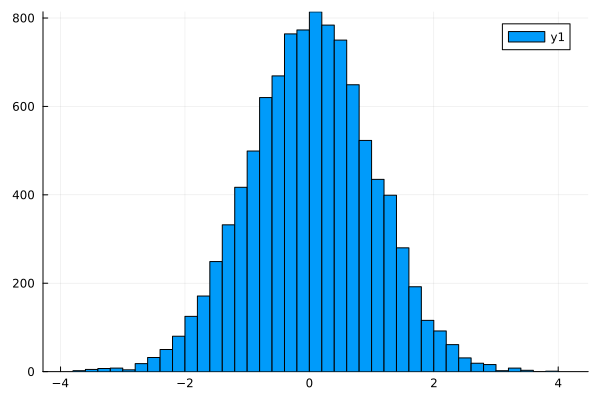

In [22]:
data2=[ForwardDiffusionFast(0.4,200,alpha1_bar) for j in 1:10000]
histogram(data2)

In [23]:
SamplePInit()=0.4

SamplePInit (generic function with 1 method)

In [3]:
Pkg.add("NNlib")

   Resolving package versions...
    Updating `~/.julia/environments/v1.10/Project.toml`
⌅ [872c559c] + NNlib v0.6.6
  No Changes to `~/.julia/environments/v1.10/Manifest.toml`
Precompiling project...
  ✓ CEnum
  ✓ SnoopPrecompile
  ✓ TreeViews
  ✓ Adapt
  ✓ SymbolicIndexingInterface
  ✓ ProgressMeter
  ✓ KLU
  ✓ IntelOpenMP_jll
  ✓ Tables
  ✓ LLVMExtra_jll
  ✓ FastLapackInterface
  ✓ FillArrays
  ✓ Distances → DistancesChainRulesCoreExt
  ✓ AbstractFFTs → AbstractFFTsChainRulesCoreExt
  ✓ IterativeSolvers
  ✓ StaticArrays → StaticArraysChainRulesCoreExt
  ✓ FilePathsBase
  ✓ LogExpFunctions → LogExpFunctionsChainRulesCoreExt
  ✓ OffsetArrays → OffsetArraysAdaptExt
  ✓ FreeType
  ✓ DataStructures
  ✓ MKL_jll
  ✓ Adapt → AdaptStaticArraysExt
  ✓ ArrayInterfaceCore
  ✓ Mustache
  ✓ FilePaths
  ✓ SortingAlgorithms
  ✓ Reactive
  ✓ QuadGK
  ✓ GPUArraysCore
  ✓ SpecialFunctions → SpecialFunctionsChainRulesCoreExt
  ✓ ArrayInterfaceStaticArraysCore
  ✓ ArrayInterface
  ✓ Graphs
  ✓ ArrayLayo

In [5]:
Pkg.add("Torch")

   Resolving package versions...
  No Changes to `~/.julia/environments/v1.10/Project.toml`
  No Changes to `~/.julia/environments/v1.10/Manifest.toml`


In [6]:
using Torch

Precompiling Torch
  ✗ BinaryProvider
  ✗ NNlib
        Info Given Torch was explicitly requested, output will be shown live 
ERROR: LoadError: SystemError: opening file "/Users/emueller/.julia/packages/NNlib/FAI3o/deps/deps.jl": No such file or directory
Stacktrace:
  [1] systemerror(p::String, errno::Int32; extrainfo::Nothing)
    @ Base ./error.jl:176
  [2] systemerror
    @ ./error.jl:175 [inlined]
  [3] open(fname::String; lock::Bool, read::Nothing, write::Nothing, create::Nothing, truncate::Nothing, append::Nothing)
    @ Base ./iostream.jl:293
  [4] open
    @ ./iostream.jl:275 [inlined]
  [5] open(f::Base.var"#433#434"{String}, args::String; kwargs::@Kwargs{})
    @ Base ./io.jl:394
  [6] open
    @ ./io.jl:393 [inlined]
  [7] read
    @ ./io.jl:486 [inlined]
  [8] _include(mapexpr::Function, mod::Module, _path::String)
    @ Base ./loading.jl:2132
  [9] include(mod::Module, _path::String)
    @ Base ./Base.jl:495
 [10] include(x::String)
    @ NNlib ~/.julia/packages/NNlib/FAI

LoadError: The following 2 direct dependencies failed to precompile:

Torch [6a2ea274-3061-11ea-0d63-ff850051a295]

Failed to precompile Torch [6a2ea274-3061-11ea-0d63-ff850051a295] to "/Users/emueller/.julia/compiled/v1.10/Torch/jl_z3nAre".
[91m[1mERROR: [22m[39mLoadError: SystemError: opening file "/Users/emueller/.julia/packages/NNlib/FAI3o/deps/deps.jl": No such file or directory
Stacktrace:
  [1] [0m[1msystemerror[22m[0m[1m([22m[90mp[39m::[0mString, [90merrno[39m::[0mInt32; [90mextrainfo[39m::[0mNothing[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4merror.jl:176[24m[39m
  [2] [0m[1msystemerror[22m
[90m    @[39m [90m./[39m[90m[4merror.jl:175[24m[39m[90m [inlined][39m
  [3] [0m[1mopen[22m[0m[1m([22m[90mfname[39m::[0mString; [90mlock[39m::[0mBool, [90mread[39m::[0mNothing, [90mwrite[39m::[0mNothing, [90mcreate[39m::[0mNothing, [90mtruncate[39m::[0mNothing, [90mappend[39m::[0mNothing[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4miostream.jl:293[24m[39m
  [4] [0m[1mopen[22m
[90m    @[39m [90m./[39m[90m[4miostream.jl:275[24m[39m[90m [inlined][39m
  [5] [0m[1mopen[22m[0m[1m([22m[90mf[39m::[0mBase.var"#433#434"[90m{String}[39m, [90margs[39m::[0mString; [90mkwargs[39m::[0m@Kwargs[90m{}[39m[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4mio.jl:394[24m[39m
  [6] [0m[1mopen[22m
[90m    @[39m [90m./[39m[90m[4mio.jl:393[24m[39m[90m [inlined][39m
  [7] [0m[1mread[22m
[90m    @[39m [90m./[39m[90m[4mio.jl:486[24m[39m[90m [inlined][39m
  [8] [0m[1m_include[22m[0m[1m([22m[90mmapexpr[39m::[0mFunction, [90mmod[39m::[0mModule, [90m_path[39m::[0mString[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4mloading.jl:2132[24m[39m
  [9] [0m[1minclude[22m[0m[1m([22m[90mmod[39m::[0mModule, [90m_path[39m::[0mString[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4mBase.jl:495[24m[39m
 [10] [0m[1minclude[22m[0m[1m([22m[90mx[39m::[0mString[0m[1m)[22m
[90m    @[39m [35mNNlib[39m [90m~/.julia/packages/NNlib/FAI3o/src/[39m[90m[4mNNlib.jl:1[24m[39m
 [11] top-level scope
[90m    @[39m [90m~/.julia/packages/NNlib/FAI3o/src/[39m[90m[4mNNlib.jl:8[24m[39m
 [12] [0m[1minclude[22m
[90m    @[39m [90m./[39m[90m[4mBase.jl:495[24m[39m[90m [inlined][39m
 [13] [0m[1minclude_package_for_output[22m[0m[1m([22m[90mpkg[39m::[0mBase.PkgId, [90minput[39m::[0mString, [90mdepot_path[39m::[0mVector[90m{String}[39m, [90mdl_load_path[39m::[0mVector[90m{String}[39m, [90mload_path[39m::[0mVector[90m{String}[39m, [90mconcrete_deps[39m::[0mVector[90m{Pair{Base.PkgId, UInt128}}[39m, [90msource[39m::[0mString[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4mloading.jl:2222[24m[39m
 [14] top-level scope
[90m    @[39m [90m[4mstdin:3[24m[39m
in expression starting at /Users/emueller/.julia/packages/NNlib/FAI3o/src/NNlib.jl:1
in expression starting at stdin:3
[91m[1mERROR: [22m[39mLoadError: Failed to precompile NNlib [872c559c-99b0-510c-b3b7-b6c96a88d5cd] to "/Users/emueller/.julia/compiled/v1.10/NNlib/jl_yfGJfR".
Stacktrace:
  [1] [0m[1merror[22m[0m[1m([22m[90ms[39m::[0mString[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4merror.jl:35[24m[39m
  [2] [0m[1mcompilecache[22m[0m[1m([22m[90mpkg[39m::[0mBase.PkgId, [90mpath[39m::[0mString, [90minternal_stderr[39m::[0mIO, [90minternal_stdout[39m::[0mIO, [90mkeep_loaded_modules[39m::[0mBool[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4mloading.jl:2468[24m[39m
  [3] [0m[1mcompilecache[22m
[90m    @[39m [90m./[39m[90m[4mloading.jl:2340[24m[39m[90m [inlined][39m
  [4] [0m[1m(::Base.var"#968#969"{Base.PkgId})[22m[0m[1m([22m[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4mloading.jl:1974[24m[39m
  [5] [0m[1mmkpidlock[22m[0m[1m([22m[90mf[39m::[0mBase.var"#968#969"[90m{Base.PkgId}[39m, [90mat[39m::[0mString, [90mpid[39m::[0mInt32; [90mkwopts[39m::[0m@Kwargs[90m{stale_age::Int64, wait::Bool}[39m[0m[1m)[22m
[90m    @[39m [35mFileWatching.Pidfile[39m [90m/Applications/Julia-1.10.app/Contents/Resources/julia/share/julia/stdlib/v1.10/FileWatching/src/[39m[90m[4mpidfile.jl:93[24m[39m
  [6] [0m[1m#mkpidlock#6[22m
[90m    @[39m [90m/Applications/Julia-1.10.app/Contents/Resources/julia/share/julia/stdlib/v1.10/FileWatching/src/[39m[90m[4mpidfile.jl:88[24m[39m[90m [inlined][39m
  [7] [0m[1mtrymkpidlock[22m[0m[1m([22m::[0mFunction, ::[0mVararg[90m{Any}[39m; [90mkwargs[39m::[0m@Kwargs[90m{stale_age::Int64}[39m[0m[1m)[22m
[90m    @[39m [35mFileWatching.Pidfile[39m [90m/Applications/Julia-1.10.app/Contents/Resources/julia/share/julia/stdlib/v1.10/FileWatching/src/[39m[90m[4mpidfile.jl:111[24m[39m
  [8] [0m[1m#invokelatest#2[22m
[90m    @[39m [90m./[39m[90m[4messentials.jl:894[24m[39m[90m [inlined][39m
  [9] [0m[1minvokelatest[22m
[90m    @[39m [90m./[39m[90m[4messentials.jl:889[24m[39m[90m [inlined][39m
 [10] [0m[1mmaybe_cachefile_lock[22m[0m[1m([22m[90mf[39m::[0mBase.var"#968#969"[90m{Base.PkgId}[39m, [90mpkg[39m::[0mBase.PkgId, [90msrcpath[39m::[0mString; [90mstale_age[39m::[0mInt64[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4mloading.jl:2983[24m[39m
 [11] [0m[1mmaybe_cachefile_lock[22m
[90m    @[39m [90m./[39m[90m[4mloading.jl:2980[24m[39m[90m [inlined][39m
 [12] [0m[1m_require[22m[0m[1m([22m[90mpkg[39m::[0mBase.PkgId, [90menv[39m::[0mString[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4mloading.jl:1970[24m[39m
 [13] [0m[1m__require_prelocked[22m[0m[1m([22m[90muuidkey[39m::[0mBase.PkgId, [90menv[39m::[0mString[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4mloading.jl:1812[24m[39m
 [14] [0m[1m#invoke_in_world#3[22m
[90m    @[39m [90m./[39m[90m[4messentials.jl:926[24m[39m[90m [inlined][39m
 [15] [0m[1minvoke_in_world[22m
[90m    @[39m [90m./[39m[90m[4messentials.jl:923[24m[39m[90m [inlined][39m
 [16] [0m[1m_require_prelocked[22m[0m[1m([22m[90muuidkey[39m::[0mBase.PkgId, [90menv[39m::[0mString[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4mloading.jl:1803[24m[39m
 [17] [0m[1mmacro expansion[22m
[90m    @[39m [90m./[39m[90m[4mloading.jl:1790[24m[39m[90m [inlined][39m
 [18] [0m[1mmacro expansion[22m
[90m    @[39m [90m./[39m[90m[4mlock.jl:267[24m[39m[90m [inlined][39m
 [19] [0m[1m__require[22m[0m[1m([22m[90minto[39m::[0mModule, [90mmod[39m::[0mSymbol[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4mloading.jl:1753[24m[39m
 [20] [0m[1m#invoke_in_world#3[22m
[90m    @[39m [90m./[39m[90m[4messentials.jl:926[24m[39m[90m [inlined][39m
 [21] [0m[1minvoke_in_world[22m
[90m    @[39m [90m./[39m[90m[4messentials.jl:923[24m[39m[90m [inlined][39m
 [22] [0m[1mrequire[22m[0m[1m([22m[90minto[39m::[0mModule, [90mmod[39m::[0mSymbol[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4mloading.jl:1746[24m[39m
 [23] [0m[1minclude[22m
[90m    @[39m [90m./[39m[90m[4mBase.jl:495[24m[39m[90m [inlined][39m
 [24] [0m[1minclude_package_for_output[22m[0m[1m([22m[90mpkg[39m::[0mBase.PkgId, [90minput[39m::[0mString, [90mdepot_path[39m::[0mVector[90m{String}[39m, [90mdl_load_path[39m::[0mVector[90m{String}[39m, [90mload_path[39m::[0mVector[90m{String}[39m, [90mconcrete_deps[39m::[0mVector[90m{Pair{Base.PkgId, UInt128}}[39m, [90msource[39m::[0mNothing[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4mloading.jl:2222[24m[39m
 [25] top-level scope
[90m    @[39m [90m[4mstdin:3[24m[39m
in expression starting at /Users/emueller/.julia/packages/Torch/ASIvw/src/Torch.jl:1
in expression starting at stdin:3
NNlib [872c559c-99b0-510c-b3b7-b6c96a88d5cd]

Failed to precompile NNlib [872c559c-99b0-510c-b3b7-b6c96a88d5cd] to "/Users/emueller/.julia/compiled/v1.10/NNlib/jl_Obto2x".
[91m[1mERROR: [22m[39mLoadError: SystemError: opening file "/Users/emueller/.julia/packages/NNlib/FAI3o/deps/deps.jl": No such file or directory
Stacktrace:
  [1] [0m[1msystemerror[22m[0m[1m([22m[90mp[39m::[0mString, [90merrno[39m::[0mInt32; [90mextrainfo[39m::[0mNothing[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4merror.jl:176[24m[39m
  [2] [0m[1msystemerror[22m
[90m    @[39m [90m./[39m[90m[4merror.jl:175[24m[39m[90m [inlined][39m
  [3] [0m[1mopen[22m[0m[1m([22m[90mfname[39m::[0mString; [90mlock[39m::[0mBool, [90mread[39m::[0mNothing, [90mwrite[39m::[0mNothing, [90mcreate[39m::[0mNothing, [90mtruncate[39m::[0mNothing, [90mappend[39m::[0mNothing[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4miostream.jl:293[24m[39m
  [4] [0m[1mopen[22m
[90m    @[39m [90m./[39m[90m[4miostream.jl:275[24m[39m[90m [inlined][39m
  [5] [0m[1mopen[22m[0m[1m([22m[90mf[39m::[0mBase.var"#433#434"[90m{String}[39m, [90margs[39m::[0mString; [90mkwargs[39m::[0m@Kwargs[90m{}[39m[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4mio.jl:394[24m[39m
  [6] [0m[1mopen[22m
[90m    @[39m [90m./[39m[90m[4mio.jl:393[24m[39m[90m [inlined][39m
  [7] [0m[1mread[22m
[90m    @[39m [90m./[39m[90m[4mio.jl:486[24m[39m[90m [inlined][39m
  [8] [0m[1m_include[22m[0m[1m([22m[90mmapexpr[39m::[0mFunction, [90mmod[39m::[0mModule, [90m_path[39m::[0mString[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4mloading.jl:2132[24m[39m
  [9] [0m[1minclude[22m[0m[1m([22m[90mmod[39m::[0mModule, [90m_path[39m::[0mString[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4mBase.jl:495[24m[39m
 [10] [0m[1minclude[22m[0m[1m([22m[90mx[39m::[0mString[0m[1m)[22m
[90m    @[39m [35mNNlib[39m [90m~/.julia/packages/NNlib/FAI3o/src/[39m[90m[4mNNlib.jl:1[24m[39m
 [11] top-level scope
[90m    @[39m [90m~/.julia/packages/NNlib/FAI3o/src/[39m[90m[4mNNlib.jl:8[24m[39m
 [12] [0m[1minclude[22m
[90m    @[39m [90m./[39m[90m[4mBase.jl:495[24m[39m[90m [inlined][39m
 [13] [0m[1minclude_package_for_output[22m[0m[1m([22m[90mpkg[39m::[0mBase.PkgId, [90minput[39m::[0mString, [90mdepot_path[39m::[0mVector[90m{String}[39m, [90mdl_load_path[39m::[0mVector[90m{String}[39m, [90mload_path[39m::[0mVector[90m{String}[39m, [90mconcrete_deps[39m::[0mVector[90m{Pair{Base.PkgId, UInt128}}[39m, [90msource[39m::[0mNothing[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4mloading.jl:2222[24m[39m
 [14] top-level scope
[90m    @[39m [90m[4mstdin:3[24m[39m
in expression starting at /Users/emueller/.julia/packages/NNlib/FAI3o/src/NNlib.jl:1
in expression starting at stdin:3

In [7]:
using NNlib

Precompiling NNlib
  ✗ BinaryProvider
        Info Given NNlib was explicitly requested, output will be shown live 
ERROR: LoadError: SystemError: opening file "/Users/emueller/.julia/packages/NNlib/FAI3o/deps/deps.jl": No such file or directory
Stacktrace:
  [1] systemerror(p::String, errno::Int32; extrainfo::Nothing)
    @ Base ./error.jl:176
  [2] systemerror
    @ ./error.jl:175 [inlined]
  [3] open(fname::String; lock::Bool, read::Nothing, write::Nothing, create::Nothing, truncate::Nothing, append::Nothing)
    @ Base ./iostream.jl:293
  [4] open
    @ ./iostream.jl:275 [inlined]
  [5] open(f::Base.var"#433#434"{String}, args::String; kwargs::@Kwargs{})
    @ Base ./io.jl:394
  [6] open
    @ ./io.jl:393 [inlined]
  [7] read
    @ ./io.jl:486 [inlined]
  [8] _include(mapexpr::Function, mod::Module, _path::String)
    @ Base ./loading.jl:2132
  [9] include(mod::Module, _path::String)
    @ Base ./Base.jl:495
 [10] include(x::String)
    @ NNlib ~/.julia/packages/NNlib/FAI3o/src/NNl

LoadError: The following 1 direct dependency failed to precompile:

NNlib [872c559c-99b0-510c-b3b7-b6c96a88d5cd]

Failed to precompile NNlib [872c559c-99b0-510c-b3b7-b6c96a88d5cd] to "/Users/emueller/.julia/compiled/v1.10/NNlib/jl_xV6HXS".
[91m[1mERROR: [22m[39mLoadError: SystemError: opening file "/Users/emueller/.julia/packages/NNlib/FAI3o/deps/deps.jl": No such file or directory
Stacktrace:
  [1] [0m[1msystemerror[22m[0m[1m([22m[90mp[39m::[0mString, [90merrno[39m::[0mInt32; [90mextrainfo[39m::[0mNothing[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4merror.jl:176[24m[39m
  [2] [0m[1msystemerror[22m
[90m    @[39m [90m./[39m[90m[4merror.jl:175[24m[39m[90m [inlined][39m
  [3] [0m[1mopen[22m[0m[1m([22m[90mfname[39m::[0mString; [90mlock[39m::[0mBool, [90mread[39m::[0mNothing, [90mwrite[39m::[0mNothing, [90mcreate[39m::[0mNothing, [90mtruncate[39m::[0mNothing, [90mappend[39m::[0mNothing[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4miostream.jl:293[24m[39m
  [4] [0m[1mopen[22m
[90m    @[39m [90m./[39m[90m[4miostream.jl:275[24m[39m[90m [inlined][39m
  [5] [0m[1mopen[22m[0m[1m([22m[90mf[39m::[0mBase.var"#433#434"[90m{String}[39m, [90margs[39m::[0mString; [90mkwargs[39m::[0m@Kwargs[90m{}[39m[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4mio.jl:394[24m[39m
  [6] [0m[1mopen[22m
[90m    @[39m [90m./[39m[90m[4mio.jl:393[24m[39m[90m [inlined][39m
  [7] [0m[1mread[22m
[90m    @[39m [90m./[39m[90m[4mio.jl:486[24m[39m[90m [inlined][39m
  [8] [0m[1m_include[22m[0m[1m([22m[90mmapexpr[39m::[0mFunction, [90mmod[39m::[0mModule, [90m_path[39m::[0mString[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4mloading.jl:2132[24m[39m
  [9] [0m[1minclude[22m[0m[1m([22m[90mmod[39m::[0mModule, [90m_path[39m::[0mString[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4mBase.jl:495[24m[39m
 [10] [0m[1minclude[22m[0m[1m([22m[90mx[39m::[0mString[0m[1m)[22m
[90m    @[39m [35mNNlib[39m [90m~/.julia/packages/NNlib/FAI3o/src/[39m[90m[4mNNlib.jl:1[24m[39m
 [11] top-level scope
[90m    @[39m [90m~/.julia/packages/NNlib/FAI3o/src/[39m[90m[4mNNlib.jl:8[24m[39m
 [12] [0m[1minclude[22m
[90m    @[39m [90m./[39m[90m[4mBase.jl:495[24m[39m[90m [inlined][39m
 [13] [0m[1minclude_package_for_output[22m[0m[1m([22m[90mpkg[39m::[0mBase.PkgId, [90minput[39m::[0mString, [90mdepot_path[39m::[0mVector[90m{String}[39m, [90mdl_load_path[39m::[0mVector[90m{String}[39m, [90mload_path[39m::[0mVector[90m{String}[39m, [90mconcrete_deps[39m::[0mVector[90m{Pair{Base.PkgId, UInt128}}[39m, [90msource[39m::[0mNothing[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4mloading.jl:2222[24m[39m
 [14] top-level scope
[90m    @[39m [90m[4mstdin:3[24m[39m
in expression starting at /Users/emueller/.julia/packages/NNlib/FAI3o/src/NNlib.jl:1
in expression starting at stdin:

In [9]:
using Torch

Precompiling Torch
  ✗ BinaryProvider
  ✗ NNlib
        Info Given Torch was explicitly requested, output will be shown live 
ERROR: LoadError: SystemError: opening file "/Users/emueller/.julia/packages/NNlib/FAI3o/deps/deps.jl": No such file or directory
Stacktrace:
  [1] systemerror(p::String, errno::Int32; extrainfo::Nothing)
    @ Base ./error.jl:176
  [2] systemerror
    @ ./error.jl:175 [inlined]
  [3] open(fname::String; lock::Bool, read::Nothing, write::Nothing, create::Nothing, truncate::Nothing, append::Nothing)
    @ Base ./iostream.jl:293
  [4] open
    @ ./iostream.jl:275 [inlined]
  [5] open(f::Base.var"#433#434"{String}, args::String; kwargs::@Kwargs{})
    @ Base ./io.jl:394
  [6] open
    @ ./io.jl:393 [inlined]
  [7] read
    @ ./io.jl:486 [inlined]
  [8] _include(mapexpr::Function, mod::Module, _path::String)
    @ Base ./loading.jl:2132
  [9] include(mod::Module, _path::String)
    @ Base ./Base.jl:495
 [10] include(x::String)
    @ NNlib ~/.julia/packages/NNlib/FAI

LoadError: The following 2 direct dependencies failed to precompile:

Torch [6a2ea274-3061-11ea-0d63-ff850051a295]

Failed to precompile Torch [6a2ea274-3061-11ea-0d63-ff850051a295] to "/Users/emueller/.julia/compiled/v1.10/Torch/jl_skcDh3".
[91m[1mERROR: [22m[39mLoadError: SystemError: opening file "/Users/emueller/.julia/packages/NNlib/FAI3o/deps/deps.jl": No such file or directory
Stacktrace:
  [1] [0m[1msystemerror[22m[0m[1m([22m[90mp[39m::[0mString, [90merrno[39m::[0mInt32; [90mextrainfo[39m::[0mNothing[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4merror.jl:176[24m[39m
  [2] [0m[1msystemerror[22m
[90m    @[39m [90m./[39m[90m[4merror.jl:175[24m[39m[90m [inlined][39m
  [3] [0m[1mopen[22m[0m[1m([22m[90mfname[39m::[0mString; [90mlock[39m::[0mBool, [90mread[39m::[0mNothing, [90mwrite[39m::[0mNothing, [90mcreate[39m::[0mNothing, [90mtruncate[39m::[0mNothing, [90mappend[39m::[0mNothing[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4miostream.jl:293[24m[39m
  [4] [0m[1mopen[22m
[90m    @[39m [90m./[39m[90m[4miostream.jl:275[24m[39m[90m [inlined][39m
  [5] [0m[1mopen[22m[0m[1m([22m[90mf[39m::[0mBase.var"#433#434"[90m{String}[39m, [90margs[39m::[0mString; [90mkwargs[39m::[0m@Kwargs[90m{}[39m[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4mio.jl:394[24m[39m
  [6] [0m[1mopen[22m
[90m    @[39m [90m./[39m[90m[4mio.jl:393[24m[39m[90m [inlined][39m
  [7] [0m[1mread[22m
[90m    @[39m [90m./[39m[90m[4mio.jl:486[24m[39m[90m [inlined][39m
  [8] [0m[1m_include[22m[0m[1m([22m[90mmapexpr[39m::[0mFunction, [90mmod[39m::[0mModule, [90m_path[39m::[0mString[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4mloading.jl:2132[24m[39m
  [9] [0m[1minclude[22m[0m[1m([22m[90mmod[39m::[0mModule, [90m_path[39m::[0mString[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4mBase.jl:495[24m[39m
 [10] [0m[1minclude[22m[0m[1m([22m[90mx[39m::[0mString[0m[1m)[22m
[90m    @[39m [35mNNlib[39m [90m~/.julia/packages/NNlib/FAI3o/src/[39m[90m[4mNNlib.jl:1[24m[39m
 [11] top-level scope
[90m    @[39m [90m~/.julia/packages/NNlib/FAI3o/src/[39m[90m[4mNNlib.jl:8[24m[39m
 [12] [0m[1minclude[22m
[90m    @[39m [90m./[39m[90m[4mBase.jl:495[24m[39m[90m [inlined][39m
 [13] [0m[1minclude_package_for_output[22m[0m[1m([22m[90mpkg[39m::[0mBase.PkgId, [90minput[39m::[0mString, [90mdepot_path[39m::[0mVector[90m{String}[39m, [90mdl_load_path[39m::[0mVector[90m{String}[39m, [90mload_path[39m::[0mVector[90m{String}[39m, [90mconcrete_deps[39m::[0mVector[90m{Pair{Base.PkgId, UInt128}}[39m, [90msource[39m::[0mString[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4mloading.jl:2222[24m[39m
 [14] top-level scope
[90m    @[39m [90m[4mstdin:3[24m[39m
in expression starting at /Users/emueller/.julia/packages/NNlib/FAI3o/src/NNlib.jl:1
in expression starting at stdin:3
[91m[1mERROR: [22m[39mLoadError: Failed to precompile NNlib [872c559c-99b0-510c-b3b7-b6c96a88d5cd] to "/Users/emueller/.julia/compiled/v1.10/NNlib/jl_T4Orr8".
Stacktrace:
  [1] [0m[1merror[22m[0m[1m([22m[90ms[39m::[0mString[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4merror.jl:35[24m[39m
  [2] [0m[1mcompilecache[22m[0m[1m([22m[90mpkg[39m::[0mBase.PkgId, [90mpath[39m::[0mString, [90minternal_stderr[39m::[0mIO, [90minternal_stdout[39m::[0mIO, [90mkeep_loaded_modules[39m::[0mBool[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4mloading.jl:2468[24m[39m
  [3] [0m[1mcompilecache[22m
[90m    @[39m [90m./[39m[90m[4mloading.jl:2340[24m[39m[90m [inlined][39m
  [4] [0m[1m(::Base.var"#968#969"{Base.PkgId})[22m[0m[1m([22m[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4mloading.jl:1974[24m[39m
  [5] [0m[1mmkpidlock[22m[0m[1m([22m[90mf[39m::[0mBase.var"#968#969"[90m{Base.PkgId}[39m, [90mat[39m::[0mString, [90mpid[39m::[0mInt32; [90mkwopts[39m::[0m@Kwargs[90m{stale_age::Int64, wait::Bool}[39m[0m[1m)[22m
[90m    @[39m [35mFileWatching.Pidfile[39m [90m/Applications/Julia-1.10.app/Contents/Resources/julia/share/julia/stdlib/v1.10/FileWatching/src/[39m[90m[4mpidfile.jl:93[24m[39m
  [6] [0m[1m#mkpidlock#6[22m
[90m    @[39m [90m/Applications/Julia-1.10.app/Contents/Resources/julia/share/julia/stdlib/v1.10/FileWatching/src/[39m[90m[4mpidfile.jl:88[24m[39m[90m [inlined][39m
  [7] [0m[1mtrymkpidlock[22m[0m[1m([22m::[0mFunction, ::[0mVararg[90m{Any}[39m; [90mkwargs[39m::[0m@Kwargs[90m{stale_age::Int64}[39m[0m[1m)[22m
[90m    @[39m [35mFileWatching.Pidfile[39m [90m/Applications/Julia-1.10.app/Contents/Resources/julia/share/julia/stdlib/v1.10/FileWatching/src/[39m[90m[4mpidfile.jl:111[24m[39m
  [8] [0m[1m#invokelatest#2[22m
[90m    @[39m [90m./[39m[90m[4messentials.jl:894[24m[39m[90m [inlined][39m
  [9] [0m[1minvokelatest[22m
[90m    @[39m [90m./[39m[90m[4messentials.jl:889[24m[39m[90m [inlined][39m
 [10] [0m[1mmaybe_cachefile_lock[22m[0m[1m([22m[90mf[39m::[0mBase.var"#968#969"[90m{Base.PkgId}[39m, [90mpkg[39m::[0mBase.PkgId, [90msrcpath[39m::[0mString; [90mstale_age[39m::[0mInt64[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4mloading.jl:2983[24m[39m
 [11] [0m[1mmaybe_cachefile_lock[22m
[90m    @[39m [90m./[39m[90m[4mloading.jl:2980[24m[39m[90m [inlined][39m
 [12] [0m[1m_require[22m[0m[1m([22m[90mpkg[39m::[0mBase.PkgId, [90menv[39m::[0mString[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4mloading.jl:1970[24m[39m
 [13] [0m[1m__require_prelocked[22m[0m[1m([22m[90muuidkey[39m::[0mBase.PkgId, [90menv[39m::[0mString[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4mloading.jl:1812[24m[39m
 [14] [0m[1m#invoke_in_world#3[22m
[90m    @[39m [90m./[39m[90m[4messentials.jl:926[24m[39m[90m [inlined][39m
 [15] [0m[1minvoke_in_world[22m
[90m    @[39m [90m./[39m[90m[4messentials.jl:923[24m[39m[90m [inlined][39m
 [16] [0m[1m_require_prelocked[22m[0m[1m([22m[90muuidkey[39m::[0mBase.PkgId, [90menv[39m::[0mString[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4mloading.jl:1803[24m[39m
 [17] [0m[1mmacro expansion[22m
[90m    @[39m [90m./[39m[90m[4mloading.jl:1790[24m[39m[90m [inlined][39m
 [18] [0m[1mmacro expansion[22m
[90m    @[39m [90m./[39m[90m[4mlock.jl:267[24m[39m[90m [inlined][39m
 [19] [0m[1m__require[22m[0m[1m([22m[90minto[39m::[0mModule, [90mmod[39m::[0mSymbol[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4mloading.jl:1753[24m[39m
 [20] [0m[1m#invoke_in_world#3[22m
[90m    @[39m [90m./[39m[90m[4messentials.jl:926[24m[39m[90m [inlined][39m
 [21] [0m[1minvoke_in_world[22m
[90m    @[39m [90m./[39m[90m[4messentials.jl:923[24m[39m[90m [inlined][39m
 [22] [0m[1mrequire[22m[0m[1m([22m[90minto[39m::[0mModule, [90mmod[39m::[0mSymbol[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4mloading.jl:1746[24m[39m
 [23] [0m[1minclude[22m
[90m    @[39m [90m./[39m[90m[4mBase.jl:495[24m[39m[90m [inlined][39m
 [24] [0m[1minclude_package_for_output[22m[0m[1m([22m[90mpkg[39m::[0mBase.PkgId, [90minput[39m::[0mString, [90mdepot_path[39m::[0mVector[90m{String}[39m, [90mdl_load_path[39m::[0mVector[90m{String}[39m, [90mload_path[39m::[0mVector[90m{String}[39m, [90mconcrete_deps[39m::[0mVector[90m{Pair{Base.PkgId, UInt128}}[39m, [90msource[39m::[0mNothing[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4mloading.jl:2222[24m[39m
 [25] top-level scope
[90m    @[39m [90m[4mstdin:3[24m[39m
in expression starting at /Users/emueller/.julia/packages/Torch/ASIvw/src/Torch.jl:1
in expression starting at stdin:3
NNlib [872c559c-99b0-510c-b3b7-b6c96a88d5cd]

Failed to precompile NNlib [872c559c-99b0-510c-b3b7-b6c96a88d5cd] to "/Users/emueller/.julia/compiled/v1.10/NNlib/jl_2Bxint".
[91m[1mERROR: [22m[39mLoadError: SystemError: opening file "/Users/emueller/.julia/packages/NNlib/FAI3o/deps/deps.jl": No such file or directory
Stacktrace:
  [1] [0m[1msystemerror[22m[0m[1m([22m[90mp[39m::[0mString, [90merrno[39m::[0mInt32; [90mextrainfo[39m::[0mNothing[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4merror.jl:176[24m[39m
  [2] [0m[1msystemerror[22m
[90m    @[39m [90m./[39m[90m[4merror.jl:175[24m[39m[90m [inlined][39m
  [3] [0m[1mopen[22m[0m[1m([22m[90mfname[39m::[0mString; [90mlock[39m::[0mBool, [90mread[39m::[0mNothing, [90mwrite[39m::[0mNothing, [90mcreate[39m::[0mNothing, [90mtruncate[39m::[0mNothing, [90mappend[39m::[0mNothing[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4miostream.jl:293[24m[39m
  [4] [0m[1mopen[22m
[90m    @[39m [90m./[39m[90m[4miostream.jl:275[24m[39m[90m [inlined][39m
  [5] [0m[1mopen[22m[0m[1m([22m[90mf[39m::[0mBase.var"#433#434"[90m{String}[39m, [90margs[39m::[0mString; [90mkwargs[39m::[0m@Kwargs[90m{}[39m[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4mio.jl:394[24m[39m
  [6] [0m[1mopen[22m
[90m    @[39m [90m./[39m[90m[4mio.jl:393[24m[39m[90m [inlined][39m
  [7] [0m[1mread[22m
[90m    @[39m [90m./[39m[90m[4mio.jl:486[24m[39m[90m [inlined][39m
  [8] [0m[1m_include[22m[0m[1m([22m[90mmapexpr[39m::[0mFunction, [90mmod[39m::[0mModule, [90m_path[39m::[0mString[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4mloading.jl:2132[24m[39m
  [9] [0m[1minclude[22m[0m[1m([22m[90mmod[39m::[0mModule, [90m_path[39m::[0mString[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4mBase.jl:495[24m[39m
 [10] [0m[1minclude[22m[0m[1m([22m[90mx[39m::[0mString[0m[1m)[22m
[90m    @[39m [35mNNlib[39m [90m~/.julia/packages/NNlib/FAI3o/src/[39m[90m[4mNNlib.jl:1[24m[39m
 [11] top-level scope
[90m    @[39m [90m~/.julia/packages/NNlib/FAI3o/src/[39m[90m[4mNNlib.jl:8[24m[39m
 [12] [0m[1minclude[22m
[90m    @[39m [90m./[39m[90m[4mBase.jl:495[24m[39m[90m [inlined][39m
 [13] [0m[1minclude_package_for_output[22m[0m[1m([22m[90mpkg[39m::[0mBase.PkgId, [90minput[39m::[0mString, [90mdepot_path[39m::[0mVector[90m{String}[39m, [90mdl_load_path[39m::[0mVector[90m{String}[39m, [90mload_path[39m::[0mVector[90m{String}[39m, [90mconcrete_deps[39m::[0mVector[90m{Pair{Base.PkgId, UInt128}}[39m, [90msource[39m::[0mNothing[0m[1m)[22m
[90m    @[39m [90mBase[39m [90m./[39m[90m[4mloading.jl:2222[24m[39m
 [14] top-level scope
[90m    @[39m [90m[4mstdin:3[24m[39m
in expression starting at /Users/emueller/.julia/packages/NNlib/FAI3o/src/NNlib.jl:1
in expression starting at stdin:3

In [15]:
Pkg.add("Torch")

   Resolving package versions...
  No Changes to `~/.julia/environments/v1.10/Project.toml`
  No Changes to `~/.julia/environments/v1.10/Manifest.toml`


In [4]:
Pkg.activate("ML")

  Activating new project at `~/Documents/Work Laptop 2011-2012/PHYS 4480-7680 Computational Physics/lectures/ML`


In [6]:
using Flux

In [8]:
Pkg.add("StatsBase")

   Resolving package versions...
    Updating `~/Documents/Work Laptop 2011-2012/PHYS 4480-7680 Computational Physics/lectures/ML/Project.toml`
  [2913bbd2] + StatsBase v0.34.3
  No Changes to `~/Documents/Work Laptop 2011-2012/PHYS 4480-7680 Computational Physics/lectures/ML/Manifest.toml`


In [18]:
Pkg.add("LaTeXStrings")

   Resolving package versions...
    Updating `~/Documents/Work Laptop 2011-2012/PHYS 4480-7680 Computational Physics/lectures/ML/Project.toml`
  [b964fa9f] + LaTeXStrings v1.3.1
  No Changes to `~/Documents/Work Laptop 2011-2012/PHYS 4480-7680 Computational Physics/lectures/ML/Manifest.toml`


In [19]:
using Plots, StatsBase,LaTeXStrings

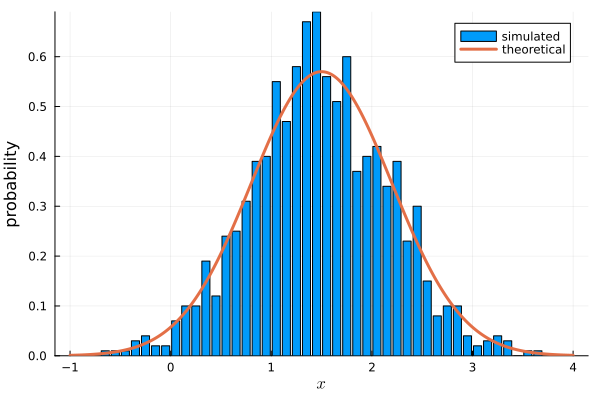

In [21]:
μ, σ, n = 1.5, 0.7, 1000
x = μ .+ σ .* randn(n);
h = fit(Histogram, x, nbins=50);
width = h.edges[1][2] - h.edges[1][1]
y = h.weights / sum(h.weights * width) ;

bar(h.edges[1], y, label="simulated", xlabel=L"x", ylabel="probability")
pdf(x, μ, σ) = 1/(σ * sqrt(2π)) * exp(-0.5 * (x - μ)^2/σ^2)
xt = -1:0.01:4
yt = pdf.(xt, μ, σ)
plot!(xt, yt, linewidth=3, label="theoretical")

In [22]:
using Random

In [23]:
function make_spiral(rng::AbstractRNG, n_samples::Int=1000)
    t_min = 1.5π
    t_max = 4.5π

    t = rand(rng, n_samples) * (t_max - t_min) .+ t_min

    x = t .* cos.(t)
    y = t .* sin.(t)

    permutedims([x y], (2, 1))
end

make_spiral(n_samples::Int=1000) = make_spiral(Random.GLOBAL_RNG, n_samples)

make_spiral (generic function with 4 methods)

In [24]:
function normalize_zero_to_one(x)
    x_min, x_max = extrema(x)
    x_norm = (x .- x_min) ./ (x_max - x_min)
    x_norm
end

function normalize_neg_one_to_one(x)
    2 * normalize_zero_to_one(x) .- 1
end

normalize_neg_one_to_one (generic function with 1 method)

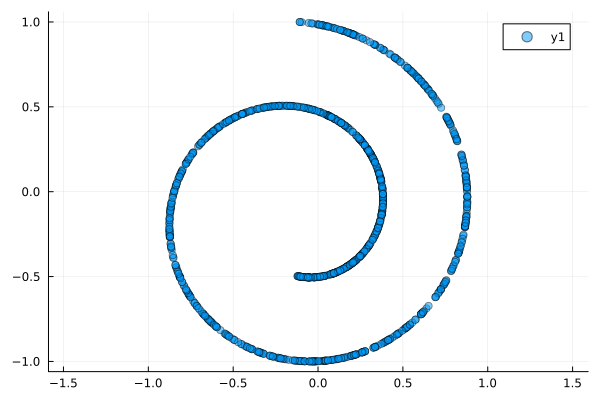

In [25]:
using Plots
n_samples = 1000
X = normalize_neg_one_to_one(make_spiral(n_samples))
scatter(X[1, :], X[2, :], 
    alpha=0.5,
    aspectratio=:equal,
    )

In [26]:
using Flux

In [27]:
using NNlib

In [29]:
Pkg.add("BSON")

   Resolving package versions...
   Installed BSON ─ v0.3.9
    Updating `~/Documents/Work Laptop 2011-2012/PHYS 4480-7680 Computational Physics/lectures/ML/Project.toml`
  [fbb218c0] + BSON v0.3.9
    Updating `~/Documents/Work Laptop 2011-2012/PHYS 4480-7680 Computational Physics/lectures/ML/Manifest.toml`
  [fbb218c0] + BSON v0.3.9
Precompiling project...
  ✓ BSON
  1 dependency successfully precompiled in 1 seconds. 242 already precompiled.


In [30]:
using BSON

In [31]:
using Printf

In [33]:
Pkg.add("ProgressMeter")

   Resolving package versions...
    Updating `~/Documents/Work Laptop 2011-2012/PHYS 4480-7680 Computational Physics/lectures/ML/Project.toml`
  [92933f4c] + ProgressMeter v1.10.1
    Updating `~/Documents/Work Laptop 2011-2012/PHYS 4480-7680 Computational Physics/lectures/ML/Manifest.toml`
  [92933f4c] + ProgressMeter v1.10.1


In [34]:
using ProgressMeter

In [35]:
using Random

In [36]:
function linear_beta_schedule(num_timesteps::Int, β_start=0.0001f0, β_end=0.02f0)
    scale = convert(typeof(β_start), 1000 / num_timesteps)
    β_start *= scale
    β_end *= scale
    range(β_start, β_end; length=num_timesteps)
end

linear_beta_schedule (generic function with 3 methods)

In [37]:
num_timesteps = 40
βs = linear_beta_schedule(num_timesteps, 8e-6, 9e-5)

0.00019999999999999998:5.256410256410257e-5:0.0022500000000000003

[ Info: Saved animation to /Users/emueller/Documents/Work Laptop 2011-2012/PHYS 4480-7680 Computational Physics/lectures/spiral_noise.gif


Plots.AnimatedGif("/Users/emueller/Documents/Work Laptop 2011-2012/PHYS 4480-7680 Computational Physics/lectures/spiral_noise.gif")
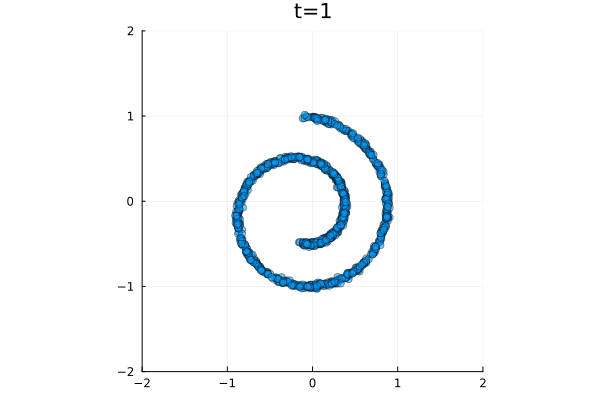

In [39]:
Xt = X
anim = @animate for t ∈ 1:(num_timesteps + 10)
    if t < num_timesteps
        μ = Xt .* sqrt(1 - βs[t])
        noise = randn((2, size(X, 2)))
        σ = sqrt(βs[t]) 
        global Xt = μ + σ .* noise
    else
        Xt = Xt
        t = num_timesteps
    end
    p = scatter(Xt[1, :], Xt[2, :], alpha=0.5, label="", 
        aspectratio=:equal,
        xlims = (-2, 2), ylims=(-2, 2),
        title="t=$t"
    )
end

gif(anim, "spiral_noise.gif", fps = 15)

In [40]:
import Base.eltype

struct GaussianDiffusion{V<:AbstractVector}
    num_timesteps::Int
    data_shape::NTuple
    denoise_fn

    βs::V
    αs::V
    α_cumprods::V
    α_cumprod_prevs::V

    sqrt_α_cumprods::V
    sqrt_one_minus_α_cumprods::V
end

eltype(::Type{<:GaussianDiffusion{V}}) where {V} = V

function GaussianDiffusion(V::DataType, βs::AbstractVector, data_shape::NTuple, denoise_fn)
    αs = 1 .- βs
    α_cumprods = cumprod(αs)
    α_cumprod_prevs = [1, (α_cumprods[1:end-1])...]

    sqrt_α_cumprods = sqrt.(α_cumprods)
    sqrt_one_minus_α_cumprods = sqrt.(1 .- α_cumprods)

    GaussianDiffusion{V}(
        length(βs),
        data_shape,
        denoise_fn,
        βs,
        αs,
        α_cumprods,
        α_cumprod_prevs,
        sqrt_α_cumprods,
        sqrt_one_minus_α_cumprods,
    )
end

GaussianDiffusion

In [41]:
function _extract(input, idxs::AbstractVector{Int}, shape::NTuple)
    reshape(input[idxs], (repeat([1], length(shape) - 1)..., :))
end

_extract (generic function with 1 method)

In [42]:
using Flux

function q_sample(
    diffusion::GaussianDiffusion, x_start::AbstractArray,
    timesteps::AbstractVector{Int}, noise::AbstractArray
    )
    coeff1 = _extract(diffusion.sqrt_α_cumprods, timesteps, size(x_start))
    coeff2 = _extract(diffusion.sqrt_one_minus_α_cumprods, timesteps, size(x_start))
    coeff1 .* x_start + coeff2 .* noise
end

function q_sample(
    diffusion::GaussianDiffusion, x_start::AbstractArray,
    timesteps::AbstractVector{Int}
    ; to_device=cpu
    )
    T = eltype(eltype(diffusion))
    noise =  randn(T, size(x_start)) |> to_device
    timesteps = timesteps |> to_device
    q_sample(diffusion, x_start, timesteps, noise)
end

function q_sample(
    diffusion::GaussianDiffusion, x_start::AbstractArray{T, N}, timestep::Int
    ; to_device=cpu
    ) where {T, N}
    timesteps = fill(timestep, size(x_start, N)) |> to_device
    q_sample(diffusion, x_start, timesteps; to_device=to_device)
end

q_sample (generic function with 3 methods)

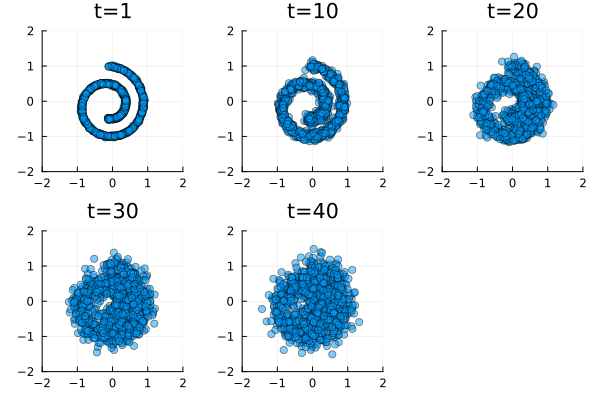

In [47]:
num_timesteps = 40
βs = linear_beta_schedule(num_timesteps, 8e-6, 9e-5)
diffusion = GaussianDiffusion(Vector{Float32}, βs, (2,), identity)
canvases = []
for frac in [0.0, 0.25, 0.5, 0.75, 1]
    local p
    timestep = max(1, ceil(Int, frac * num_timesteps))
    Xt = q_sample(diffusion, X, timestep)
    p = scatter(Xt[1, :], Xt[2, :], alpha=0.5, label="", 
        aspectratio=:equal,
        xlims = (-2, 2), ylims=(-2, 2),
        title="t=$timestep"
        )
    push!(canvases, p)
end

plot(canvases...)

# Restart Kernel

In [1]:
using Pkg
Pkg.activate("ML")
using Flux
using NNlib
using BSON
using Printf
using ProgressMeter
using Random

  Activating project at `~/Documents/Work Laptop 2011-2012/PHYS 4480-7680 Computational Physics/lectures/ML`


In [8]:
function linear_beta_schedule(num_timesteps::Int, β_start=0.0001f0, β_end=0.02f0)
    scale = convert(typeof(β_start), 1000 / num_timesteps)
    β_start *= scale
    β_end *= scale
    range(β_start, β_end; length=num_timesteps)
end
num_timesteps = 40
βs = linear_beta_schedule(num_timesteps, 8e-6, 9e-5)

0.00019999999999999998:5.256410256410257e-5:0.0022500000000000003

In [11]:
function _extract(input, idxs::AbstractVector{Int}, shape::NTuple)
    reshape(input[idxs], (repeat([1], length(shape) - 1)..., :))
end

_extract (generic function with 1 method)

In [2]:
import Base.eltype

struct GaussianDiffusion{V<:AbstractVector}
    num_timesteps::Int
    data_shape::NTuple
    denoise_fn

    βs::V
    αs::V
    α_cumprods::V
    α_cumprod_prevs::V

    sqrt_α_cumprods::V
    sqrt_one_minus_α_cumprods::V
    sqrt_recip_α_cumprods::V
    sqrt_recip_α_cumprods_minus_one::V
    posterior_variance::V
    posterior_log_variance_clipped::V
    posterior_mean_coef1::V
    posterior_mean_coef2::V
end

eltype(::Type{<:GaussianDiffusion{V}}) where {V} = V

Flux.@functor GaussianDiffusion
Flux.trainable(g::GaussianDiffusion) = (; g.denoise_fn) # only the denoise_fn is trainable

function GaussianDiffusion(
    V::DataType, βs::AbstractVector, data_shape::NTuple, denoise_fn
    )
    αs = 1 .- βs
    α_cumprods = cumprod(αs)
    α_cumprod_prevs = [1, (α_cumprods[1:end-1])...]

    sqrt_α_cumprods = sqrt.(α_cumprods)
    sqrt_one_minus_α_cumprods = sqrt.(1 .- α_cumprods)
    sqrt_recip_α_cumprods = 1 ./ sqrt.(α_cumprods)
    sqrt_recip_α_cumprods_minus_one = sqrt.(1 ./ α_cumprods .- 1)

    posterior_variance = βs .* (1 .- α_cumprod_prevs) ./ (1 .- α_cumprods)
    posterior_log_variance_clipped = log.(max.(posterior_variance, 1e-20))

    posterior_mean_coef1 = βs .* sqrt.(α_cumprod_prevs) ./ (1 .- α_cumprods)
    posterior_mean_coef2 = (1 .- α_cumprod_prevs) .* sqrt.(αs) ./ (1 .- α_cumprods)

    GaussianDiffusion{V}(
        length(βs),
        data_shape,
        denoise_fn,
        βs,
        αs,
        α_cumprods,
        α_cumprod_prevs,
        sqrt_α_cumprods,
        sqrt_one_minus_α_cumprods,
        sqrt_recip_α_cumprods,
        sqrt_recip_α_cumprods_minus_one,
        posterior_variance,
        posterior_log_variance_clipped,
        posterior_mean_coef1,
        posterior_mean_coef2
    )
end

GaussianDiffusion

In [3]:
function predict_start_from_noise(
    diffusion::GaussianDiffusion, x_t::AbstractArray,
    timesteps::AbstractVector{Int}, noise::AbstractArray
    )
    coeff1 = _extract(diffusion.sqrt_recip_α_cumprods, timesteps, size(x_t))
    coeff2 = _extract(diffusion.sqrt_recip_α_cumprods_minus_one, timesteps, size(x_t))
    coeff1 .* x_t - coeff2 .* noise
end

function denoise(
    diffusion::GaussianDiffusion, x::AbstractArray,
    timesteps::AbstractVector{Int}
    )
    noise = diffusion.denoise_fn(x, timesteps)
    x_start = predict_start_from_noise(diffusion, x, timesteps, noise)
    x_start, noise
end

denoise (generic function with 1 method)

In [4]:
function q_posterior_mean_variance(
    diffusion::GaussianDiffusion, x_start::AbstractArray, x_t::AbstractArray,
    timesteps::AbstractVector{Int}
    )
    coeff1 = _extract(diffusion.posterior_mean_coef1, timesteps, size(x_t))
    coeff2 = _extract(diffusion.posterior_mean_coef2, timesteps, size(x_t))
    posterior_mean = coeff1 .* x_start + coeff2 .* x_t
    posterior_variance = _extract(diffusion.posterior_variance, timesteps, size(x_t))
    posterior_mean, posterior_variance
end 

q_posterior_mean_variance (generic function with 1 method)

In [5]:
function p_sample(
    diffusion::GaussianDiffusion, x::AbstractArray,
    timesteps::AbstractVector{Int}, noise::AbstractArray
    ; clip_denoised::Bool=true, add_noise::Bool=true
    )
    x_start, pred_noise = denoise(diffusion, x, timesteps)
    if clip_denoised
        clamp!(x_start, -1, 1)
    end
    posterior_mean, posterior_variance = q_posterior_mean_variance(
        diffusion, x_start, x, timesteps
    )
    x_prev = posterior_mean
    if add_noise
        x_prev += sqrt.(posterior_variance) .* noise
    end
    x_prev, x_start
end

p_sample (generic function with 1 method)

In [12]:
diffusion = GaussianDiffusion(Vector{Float32}, βs, (2,), (x, t) -> randn(size(x)))
XT = randn((2, 100))
timesteps = fill(num_timesteps, 100)

x_start, pred_noise = denoise(diffusion, XT, timesteps)
posterior_mean, posterior_variance = q_posterior_mean_variance(diffusion, x_start, XT, timesteps)
noise =  randn(size(XT))
x_prev = posterior_mean + sqrt.(posterior_variance) .* noise

2×100 Matrix{Float64}:
 1.24222   1.3499   -0.445447  -1.52284   …  -1.50785    0.476751   0.409741
 0.397401  0.87485   1.01334   -0.781537      0.488476  -1.05295   -1.52315

In [13]:
using Flux, ProgressMeter
function p_sample_loop(
    diffusion::GaussianDiffusion, shape::NTuple
    ; clip_denoised::Bool=true, to_device=cpu
    )
    T = eltype(eltype(diffusion))
    x = randn(T, shape) |> to_device
    @showprogress "Sampling..." for t in diffusion.num_timesteps:-1:1
        timesteps = fill(t, shape[end]) |> to_device;
        noise =  randn(T, size(x)) |> to_device
        x, x_start = p_sample(
            diffusion, x, timesteps, noise
            ; clip_denoised=clip_denoised, add_noise=(t != 1)
        )
    end
    x
end

function p_sample_loop(diffusion::GaussianDiffusion, batch_size::Int; options...)
    p_sample_loop(diffusion, (diffusion.data_shape..., batch_size); options...)
end

p_sample_loop (generic function with 2 methods)

In [14]:
diffusion = GaussianDiffusion(Vector{Float32}, βs, (2,), (x, t) -> randn(size(x)))
X0 = p_sample_loop(diffusion, 100, clip_denoised=false)

Sampling... 100%|████████████████████████████████████████| Time: 0:00:00


2×100 Matrix{Float64}:
 -1.48237   -0.331478  -0.0795629  …   0.319879    1.78363  -0.821566
  0.487573   2.21682    0.280465      -0.0970282  -1.94136   0.180778

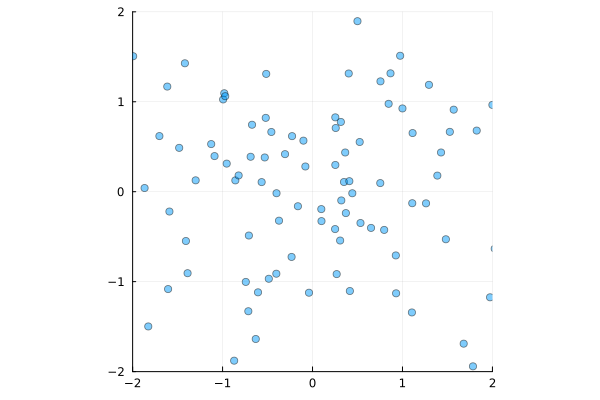

In [17]:
using Plots
 scatter(X0[1, :], X0[2, :], alpha=0.5, label="", 
        aspectratio=:equal,
        xlims = (-2, 2), ylims=(-2, 2),
        )

In [18]:
function p_sample_loop_all(
    diffusion::GaussianDiffusion, shape::NTuple
    ; clip_denoised::Bool=true, to_device=cpu
    )
    T = eltype(eltype(diffusion))
    x = randn(T, shape) |> to_device
    x_all = Array{T}(undef, size(x)..., 0) |> to_device
    x_start_all = Array{T}(undef, size(x)..., 0) |> to_device
    tdim = ndims(x_all)
    @showprogress "Sampling..." for t in diffusion.num_timesteps:-1:1
        timesteps = fill(t, shape[end]) |> to_device;
        noise =  randn(T, size(x)) |> to_device
        x, x_start = p_sample(
            diffusion, x, timesteps, noise
            ; clip_denoised=clip_denoised, add_noise=(t!= 1)
        )
        x_all = cat(x_all, x, dims=tdim)
        x_start_all = cat(x_start_all, x_start, dims=tdim)
    end
    x_all, x_start_all
end

function p_sample_loop_all(diffusion::GaussianDiffusion, batch_size::Int=16; options...)
    p_sample_loop_all(diffusion, (diffusion.data_shape..., batch_size); options...)
end

p_sample_loop_all (generic function with 3 methods)

In [19]:
using Flux
import Flux._show_children
import Flux._big_show

In [20]:
abstract type AbstractParallel end

_maybe_forward(layer::AbstractParallel, x::AbstractArray, ys::AbstractArray...) = 
    layer(x, ys...)
_maybe_forward(layer::Parallel, x::AbstractArray, ys::AbstractArray...) = 
    layer(x, ys...)
_maybe_forward(layer, x::AbstractArray, ys::AbstractArray...) = 
    layer(x)

struct ConditionalChain{T<:Union{Tuple,NamedTuple}} <: AbstractParallel
    layers::T
end
Flux.@functor ConditionalChain 

ConditionalChain(xs...) = ConditionalChain(xs)
function ConditionalChain(; kw...)
  :layers in keys(kw) && throw(ArgumentError("a Chain cannot have a named layer called `layers`"))
  isempty(kw) && return ConditionalChain(())
  ConditionalChain(values(kw))
end

Flux.@forward ConditionalChain.layers Base.getindex, Base.length, Base.first, Base.last,
Base.iterate, Base.lastindex, Base.keys, Base.firstindex

Base.getindex(c::ConditionalChain, i::AbstractArray) = ConditionalChain(c.layers[i]...)

In [21]:
function (c::ConditionalChain)(x, ys...) 
    for layer in c.layers
        x = _maybe_forward(layer, x, ys...)
    end
    x
end

In [23]:
function Base.show(io::IO, c::ConditionalChain)
    print(io, "ConditionalChain(")
    Flux._show_layers(io, c.layers)
    print(io, ")")
end

function _big_show(io::IO, m::ConditionalChain{T}, indent::Int=0, name=nothing) where T <: NamedTuple
    println(io, " "^indent, isnothing(name) ? "" : "$name = ", "ConditionalChain(")
    for k in Base.keys(m.layers)
        _big_show(io, m.layers[k], indent+2, k)
    end
    if indent == 0  
        print(io, ") ")
        _big_finale(io, m)
      else
        println(io, " "^indent, ")", ",")
    end
end

function Base.show(io::IO, m::MIME"text/plain", x::ConditionalChain)
    if get(io, :typeinfo, nothing) === nothing  # e.g. top level in REPL
        Flux._big_show(io, x)
    elseif !get(io, :compact, false)  # e.g. printed inside a Vector, but not a Matrix
        Flux._layer_show(io, x)
    else
        show(io, x)
    end
end

In [24]:
d_hid = 32
num_timesteps = 40
model = ConditionalChain(
    Parallel(.+, Dense(2, d_hid), Embedding(num_timesteps, d_hid)),
    swish,
    Parallel(.+, Dense(d_hid, d_hid), Embedding(num_timesteps, d_hid)),
    swish,
    Parallel(.+, Dense(d_hid, d_hid), Embedding(num_timesteps, d_hid)),
    swish,
    Dense(d_hid, 2),
)

ConditionalChain(
  Tuple(
    Parallel(
      Base.Broadcast.BroadcastFunction(+),
      Dense(2 => 32),                   # 96 parameters
      Embedding(40 => 32),              # 1_280 parameters
    ),
    NNlib.swish,
    Parallel(
      Base.Broadcast.BroadcastFunction(+),
      Dense(32 => 32),                  # 1_056 parameters
      Embedding(40 => 32),              # 1_280 parameters
    ),
    NNlib.swish,
    Parallel(
      Base.Broadcast.BroadcastFunction(+),
      Dense(32 => 32),                  # 1_056 parameters
      Embedding(40 => 32),              # 1_280 parameters
    ),
    NNlib.swish,
    Dense(32 => 2),                     # 66 parameters
  ),
)                   # Total: 11 arrays, 6_114 parameters, 24.711 KiB.

In [25]:
struct SinusoidalPositionEmbedding{W<:AbstractArray}
    weight::W
end

Flux.@functor SinusoidalPositionEmbedding
Flux.trainable(emb::SinusoidalPositionEmbedding) = (;) # mark it as an non-trainable array

function SinusoidalPositionEmbedding(in::Int, out::Int)
    W = make_positional_embedding(out, in)
    SinusoidalPositionEmbedding(W)
end

function make_positional_embedding(dim_embedding::Int, seq_length::Int=1000; n::Int=10000)
    embedding = Matrix{Float32}(undef, dim_embedding, seq_length)
    for pos in 1:seq_length
        for row in 0:2:(dim_embedding-1)
            denom = 1.0 / (n^(row / (dim_embedding-2)))
            embedding[row + 1, pos] = sin(pos * denom)
            embedding[row + 2, pos] = cos(pos * denom)
        end
    end
    embedding
end

(m::SinusoidalPositionEmbedding)(x::Integer) = m.weight[:, x]
(m::SinusoidalPositionEmbedding)(x::AbstractVector) = NNlib.gather(m.weight, x)
(m::SinusoidalPositionEmbedding)(x::AbstractArray) = reshape(m(vec(x)), :, size(x)...)

function Base.show(io::IO, m::SinusoidalPositionEmbedding)
    print(io, "SinusoidalPositionEmbedding(", size(m.weight, 2), " => ", size(m.weight, 1), ")")
end

In [26]:
model = ConditionalChain(
    Parallel(
        .+, 
        Dense(2, d_hid), 
        Chain(
            SinusoidalPositionEmbedding(num_timesteps, d_hid), 
            Dense(d_hid, d_hid))
        ),
    swish,
    Parallel(
        .+, 
        Dense(d_hid, d_hid), 
        Chain(
            SinusoidalPositionEmbedding(num_timesteps, d_hid), 
            Dense(d_hid, d_hid))
        ),
    swish,
    Parallel(
        .+, 
        Dense(d_hid, d_hid), 
        Chain(
            SinusoidalPositionEmbedding(num_timesteps, d_hid), 
            Dense(d_hid, d_hid))
        ),
    swish,
    Dense(d_hid, 2),
)

ConditionalChain(
  Tuple(
    Parallel(
      Base.Broadcast.BroadcastFunction(+),
      Dense(2 => 32),                   # 96 parameters
      Chain(
        SinusoidalPositionEmbedding(40 => 32),
        Dense(32 => 32),                # 1_056 parameters
      ),
    ),
    NNlib.swish,
    Parallel(
      Base.Broadcast.BroadcastFunction(+),
      Dense(32 => 32),                  # 1_056 parameters
      Chain(
        SinusoidalPositionEmbedding(40 => 32),
        Dense(32 => 32),                # 1_056 parameters
      ),
    ),
    NNlib.swish,
    Parallel(
      Base.Broadcast.BroadcastFunction(+),
      Dense(32 => 32),                  # 1_056 parameters
      Chain(
        SinusoidalPositionEmbedding(40 => 32),
        Dense(32 => 32),                # 1_056 parameters
      ),
    ),
    NNlib.swish,
    Dense(32 => 2),                     # 66 parameters
  ),
)         # Total: 14 trainable arrays, 5_442 parameters,
          # plus 3 non-trainable, 3_840 parameters, s

In [27]:
function p_losses(
    diffusion::GaussianDiffusion, loss, x_start::AbstractArray,
    timesteps::AbstractVector{Int}, noise::AbstractArray
    )
    x = q_sample(diffusion, x_start, timesteps, noise)
    model_out = diffusion.denoise_fn(x, timesteps)
    loss(model_out, noise)
end

function p_losses(
    diffusion::GaussianDiffusion, loss, x_start::AbstractArray{T, N}
    ; to_device=cpu
    ) where {T, N}
    timesteps = rand(1:diffusion.num_timesteps, size(x_start, N)) |> to_device
    noise = randn(eltype(eltype(diffusion)), size(x_start)) |> to_device
    p_losses(diffusion, loss, x_start, timesteps, noise)
end

p_losses (generic function with 2 methods)

In [28]:
using Flux: DataLoader
using ProgressMeter
using Printf

function train!(loss, model, data::DataLoader, opt_state;
    num_epochs::Int=10,
    )
    history = Dict("mean_batch_loss" => Float64[])
    for epoch = 1:num_epochs
        progress = Progress(length(data); desc="epoch $epoch/$num_epochs")
        total_loss = 0.0
        for (idx, x) in enumerate(data)
            batch_loss, grads = Flux.withgradient(model) do m
                loss(m, x)
            end
            total_loss += batch_loss
            Flux.update!(opt_state, model, grads[1])
            ProgressMeter.next!(progress)
        end
        push!(history["mean_batch_loss"], total_loss / length(data))
        @printf("mean batch loss: %.5f\n", history["mean_batch_loss"][end])
    end
    history
end

train! (generic function with 1 method)

In [31]:
using Random
function make_spiral(rng::AbstractRNG, n_samples::Int=1000)
    t_min = 1.5π
    t_max = 4.5π

    t = rand(rng, n_samples) * (t_max - t_min) .+ t_min

    x = t .* cos.(t)
    y = t .* sin.(t)

    permutedims([x y], (2, 1))
end

make_spiral(n_samples::Int=1000) = make_spiral(Random.GLOBAL_RNG, n_samples)

make_spiral (generic function with 4 methods)

In [32]:
function normalize_zero_to_one(x)
    x_min, x_max = extrema(x)
    x_norm = (x .- x_min) ./ (x_max - x_min)
    x_norm
end

function normalize_neg_one_to_one(x)
    2 * normalize_zero_to_one(x) .- 1
end

normalize_neg_one_to_one (generic function with 1 method)

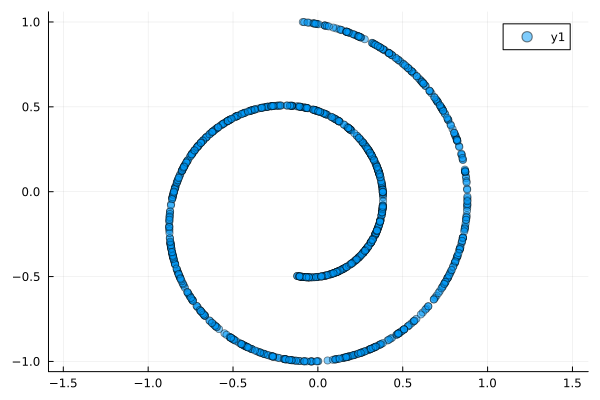

In [33]:
using Plots
n_samples = 1000
X = normalize_neg_one_to_one(make_spiral(n_samples))
scatter(X[1, :], X[2, :], 
    alpha=0.5,
    aspectratio=:equal,
    )

In [35]:
function q_sample(
    diffusion::GaussianDiffusion, x_start::AbstractArray,
    timesteps::AbstractVector{Int}, noise::AbstractArray
    )
    coeff1 = _extract(diffusion.sqrt_α_cumprods, timesteps, size(x_start))
    coeff2 = _extract(diffusion.sqrt_one_minus_α_cumprods, timesteps, size(x_start))
    coeff1 .* x_start + coeff2 .* noise
end

function q_sample(
    diffusion::GaussianDiffusion, x_start::AbstractArray,
    timesteps::AbstractVector{Int}
    ; to_device=cpu
    )
    T = eltype(eltype(diffusion))
    noise =  randn(T, size(x_start)) |> to_device
    timesteps = timesteps |> to_device
    q_sample(diffusion, x_start, timesteps, noise)
end

function q_sample(
    diffusion::GaussianDiffusion, x_start::AbstractArray{T, N}, timestep::Int
    ; to_device=cpu
    ) where {T, N}
    timesteps = fill(timestep, size(x_start, N)) |> to_device
    q_sample(diffusion, x_start, timesteps; to_device=to_device)
end

q_sample (generic function with 3 methods)

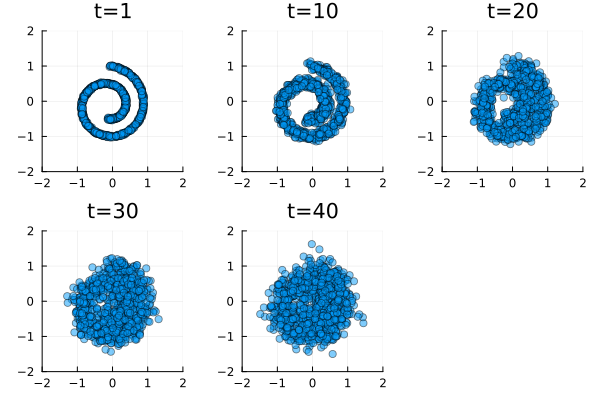

In [37]:
num_timesteps = 40
βs = linear_beta_schedule(num_timesteps, 8e-6, 9e-5)
diffusion = GaussianDiffusion(Vector{Float32}, βs, (2,), identity)
canvases = []
for frac in [0.0, 0.25, 0.5, 0.75, 1]
    local p
    timestep = max(1, ceil(Int, frac * num_timesteps))
    Xt = q_sample(diffusion, X, timestep)
    p = scatter(Xt[1, :], Xt[2, :], alpha=0.5, label="", 
        aspectratio=:equal,
        xlims = (-2, 2), ylims=(-2, 2),
        title="t=$timestep"
        )
    push!(canvases, p)
end
plot(canvases...)

In [40]:
model

ConditionalChain(
  Tuple(
    Parallel(
      Base.Broadcast.BroadcastFunction(+),
      Dense(2 => 32),                   # 96 parameters
      Chain(
        SinusoidalPositionEmbedding(40 => 32),
        Dense(32 => 32),                # 1_056 parameters
      ),
    ),
    NNlib.swish,
    Parallel(
      Base.Broadcast.BroadcastFunction(+),
      Dense(32 => 32),                  # 1_056 parameters
      Chain(
        SinusoidalPositionEmbedding(40 => 32),
        Dense(32 => 32),                # 1_056 parameters
      ),
    ),
    NNlib.swish,
    Parallel(
      Base.Broadcast.BroadcastFunction(+),
      Dense(32 => 32),                  # 1_056 parameters
      Chain(
        SinusoidalPositionEmbedding(40 => 32),
        Dense(32 => 32),                # 1_056 parameters
      ),
    ),
    NNlib.swish,
    Dense(32 => 2),                     # 66 parameters
  ),
)         # Total: 14 trainable arrays, 5_442 parameters,
          # plus 3 non-trainable, 3_840 parameters, s

In [38]:
βs = linear_beta_schedule(num_timesteps, 8e-6, 9e-5)
diffusion = GaussianDiffusion(Vector{Float32}, βs, (2,), model)
to_device=cpu

diffusion = diffusion |> to_device

train_data = Flux.DataLoader(X |> to_device; batchsize=32, shuffle=true);
loss_type = Flux.mse;
loss(diffusion, x) = p_losses(diffusion, loss_type, x; to_device=to_device)
opt = Adam(0.001);
opt_state = Flux.setup(opt, diffusion)


(num_timesteps = (), data_shape = (), denoise_fn = (layers = ((connection = (f = (),), layers = ((weight = Leaf(Adam(0.001, (0.9, 0.999), 1.0e-8), (Float32[0.0 0.0; 0.0 0.0; … ; 0.0 0.0; 0.0 0.0], Float32[0.0 0.0; 0.0 0.0; … ; 0.0 0.0; 0.0 0.0], (0.9, 0.999))), bias = Leaf(Adam(0.001, (0.9, 0.999), 1.0e-8), (Float32[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0  …  0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0], Float32[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0  …  0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0], (0.9, 0.999))), σ = ()), (layers = ((weight = (),), (weight = Leaf(Adam(0.001, (0.9, 0.999), 1.0e-8), (Float32[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0], Float32[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0], (0.9, 0.999))), bias = Leaf(Adam(0.001, (0.9, 0.999), 1.0e-8), (Float32[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0  …  0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0], Float32[0

In [39]:
history = train!(
    loss, diffusion, train_data, opt_state
    ; num_epochs=100
)

LoadError: MethodError: no method matching (::ChainRulesCore.ProjectTo{Float32, @NamedTuple{}})(::ChainRulesCore.Tangent{Any, @NamedTuple{num_timesteps::ChainRulesCore.ZeroTangent, data_shape::ChainRulesCore.ZeroTangent, denoise_fn::Float64, βs::ChainRulesCore.ZeroTangent, αs::ChainRulesCore.ZeroTangent, α_cumprods::ChainRulesCore.ZeroTangent, α_cumprod_prevs::ChainRulesCore.ZeroTangent, sqrt_α_cumprods::ChainRulesCore.ZeroTangent, sqrt_one_minus_α_cumprods::ChainRulesCore.ZeroTangent, sqrt_recip_α_cumprods::ChainRulesCore.ZeroTangent, sqrt_recip_α_cumprods_minus_one::ChainRulesCore.ZeroTangent, posterior_variance::ChainRulesCore.ZeroTangent, posterior_log_variance_clipped::ChainRulesCore.ZeroTangent, posterior_mean_coef1::ChainRulesCore.ZeroTangent, posterior_mean_coef2::ChainRulesCore.ZeroTangent}})

[0mClosest candidates are:
[0m  (::ChainRulesCore.ProjectTo{T})(::ChainRulesCore.Tangent{<:T}) where T
[0m[90m   @[39m [32mChainRulesCore[39m [90m~/.julia/packages/ChainRulesCore/I1EbV/src/[39m[90m[4mprojection.jl:143[24m[39m
[0m  (::ChainRulesCore.ProjectTo{T})([91m::ChainRulesCore.NotImplemented[39m) where T
[0m[90m   @[39m [32mChainRulesCore[39m [90m~/.julia/packages/ChainRulesCore/I1EbV/src/[39m[90m[4mprojection.jl:121[24m[39m
[0m  (::ChainRulesCore.ProjectTo{<:Number})([91m::ChainRulesCore.Tangent{<:Complex}[39m)
[0m[90m   @[39m [32mChainRulesCore[39m [90m~/.julia/packages/ChainRulesCore/I1EbV/src/[39m[90m[4mprojection.jl:192[24m[39m
[0m  ...
